### Visualisierung von Geodaten in Hexbin Plots 
Dieses Notebook gehört zu <a href='https://datenverknoten.de/?p=350' target='_blank'>einem Beitrag</a> in meinem Blog datenverknoten.de

In diesem Notebook zeige ich, wie eine einfache Visualisierung von Geodaten mit einem Hexbin Plot erstellt werden kann. Der Datensatz kann hier heruntergeladen werden (es wird ein kostenloser Kaggle Account benötigt): <a href='https://www.kaggle.com/ruiqurm/lianjia' target='_blank'>Kaggle</a>. Die Datei namens new.csv kann einfach in dieses geklonte Repository gelegt werden, oder der Pfad zur Datei muss in der übernächsten Zelle angepasst werden. 

Zunächst wird Pandas und Matplotlib importiert, um die Daten einzulesen und ein einfaces XY-Diagramm zu erstellen. Die Standardgröße der Plots wird mit dem plt.rc Befehl verändert.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
plt.rc('figure', figsize=(12, 10))

Der Datensatz enthält verschiedene Spalten, z.B. den Kaufpreis und die Anzahl der Zimmer. Dies sind alles Informationen, die unwichtig für die Visualisierung sind. Darum werden nur die Geokoordinaten (Latitude und Longitude) eingelesen. Auch sind die Immobilien zu unterschiedlichen Zeiten vekauft worden. Es ist also eine Mischung aus verschiedenen Jahren. Hier besteht die Möglichkeit, die Immobilien z.B. auf ein bestimmtes Jahr zu filtern. Dies habe ich hier nicht getan.

In [2]:
housing = pd.read_csv('new.csv',usecols=['Lat','Lng'])

Zuerst wird ein einfaches XY-Diagramm (Scatterplot) erstellt. Hieraus lässt sich bereits die Verteilung der verkauften Immobilien erkennen. Wie bereits angemerkt, die Verkäufe haben in unterschiedlichen Jahren stattgefunden. Das Problem an so einem Plot ist, dass im zentralen Bereich ein durchgängiger Fleck entsteht, bei dem lokale Konzentrationspunkte nicht zu erkennen sind. Eine Möglichkeit, dieses Problem zu lösen, wäre die Größe der Punkte zu verkleinern. Allerdings muss man dies je nach Anwendungsfall so stark ausreizen, dass einzelne Punkte verschwinden. 

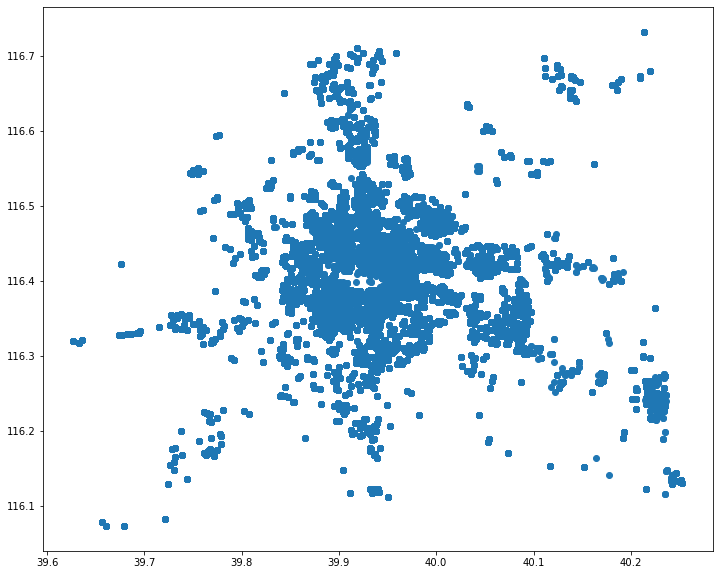

In [3]:
plt.scatter(housing['Lat'], housing['Lng'])
plt.show()

Matplotlib bietet die Möglichkeit ein Hexbin Plot der Daten zu erstellen. Ein Hexbin Plot besteht aus nebeneinanderliegenden Hexagonen, die die Konzentration der Daten in einem Hexagon farblich darstellen. So ist es möglich, den Detailgrad einer Abbildung zu verringern ohne wichtige Informationen über lokale Konzentrationsunterschiede in der Verteilung zu verlieren. Dabei werden neben den notwendigen X- und Y-Werten auch die Farbskala und die Größe des Hexagon Feldes angegeben. In diesem Fall werden 30 mal 30 Hexagone erstellt. Dadurch, dass die Farbskala mit in die ganz am Anfang festgelegte Größe der Plots einbezogen wird, wird der Plot etwas gestaucht. Das Problem aus dem vorherigen Plot, dass es nur einen dichten Farbfleck im Zentrum gibt, ist nun dadurch gelöst, dass einige der Hexagone eine dunklere Farbe ausweisen als die sie umgebenden. In diesen Hexagonen ist die Konzentration von verkauften Immobilien also deutlich erhöht. Diese lokalen Konzentrationsmaxima sind im Farbfleck zuvor nicht erkennbar.

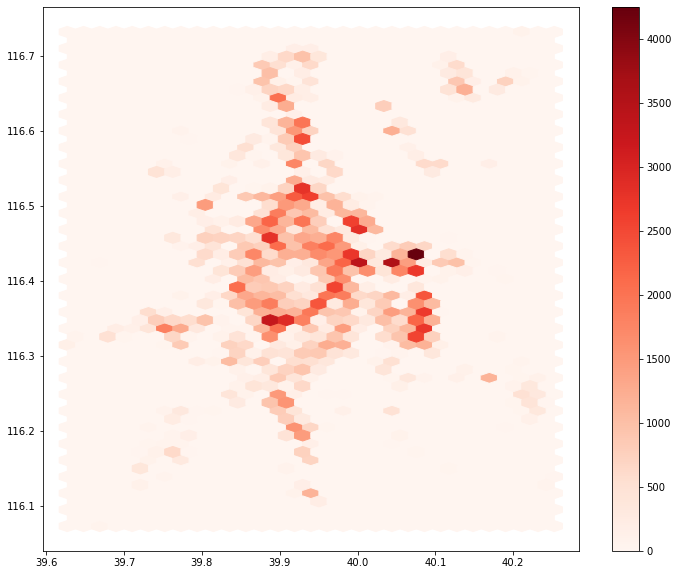

In [4]:
fig = plt.hexbin(housing['Lat'], housing['Lng'], gridsize=(30,30), cmap='Reds')
plt.colorbar()
plt.show()

Die Struktur der Stadt lässt sich aus dem Scatterplot und dem Hexbin Plot einigermaßen erkennen. Schöner wäre es jedoch, wenn auch tatsächlich die Stadt selber zu erkennen wäre, sodass man die lokalen Maxima einem Stadtteil zuordnen kann. Hierfür wird <a href='https://plotly.com' target='_blank'>Plotly Express</a> benötigt. Achtung: Für kommerzielle Zwecke sollte man sich die Lizenzbedingungen ansehen.

Als erstes sollen die Immobilien, wie beim Scatterplot, auf eine Karte geplottet werden. Plotly ist hierbei erfreulicherweise sehr unkompliziert. Nach dem Import wird <i>scatter_mapbox</i> verwendet. Dort muss ein Pandas Dataframe als Quelle angegeben werden. Die Geokoordinaten werden über <i>lat</i> und <i>lon</i> festgelegt. Dann gibt es noch allerhand Konfigurationsmöglichkeiten, wie z.B. Hoverboxen uvm. Dazu einfach die Plotly <a href='https://plotly.com/python/' target='_blank'>Dokumentation</a> konsultieren (Abschnitt maps). Die Karte wird von OpenStreetMap bereitgestellt. Mit Plotly erhält man interaktive Grafiken. In diese Karte kann man reinzoomen, hin und her scrollen und auch Screenshots aufnehmen. Die Steuerelemente dafür befinden sich in der Karte in der oberen rechten Ecke. Da der Plot eine Titelzeile hat, musste ich ein Top-margin von 25 px hinzufügen. Ansonsten wäre der Titel bei mir hinter der Zelle versteckt.

In [15]:
import plotly.express as px

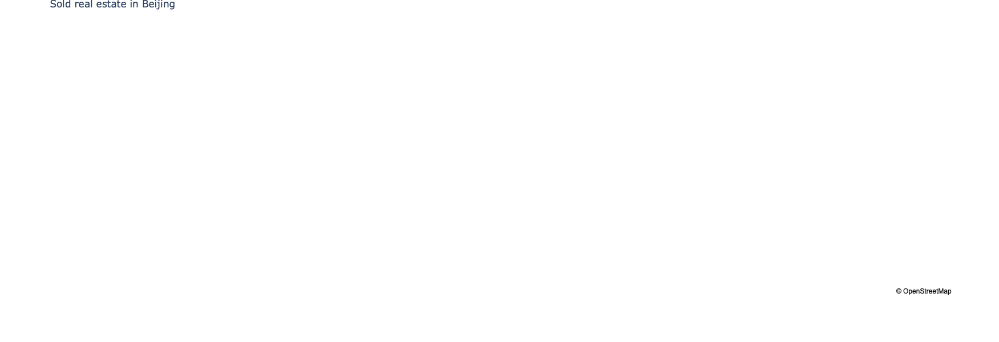

In [16]:
fig = px.scatter_mapbox(housing, lat="Lat", lon="Lng",\
                        color_discrete_sequence=["blue"], \
                        zoom=9, \
                        height=600, \
                        title = 'Sold real estate in Beijing'
                       )
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"t":25})
fig.show()

Allerdings haben wir hier wieder das Problem, dass es viele Punkte auf der Karte gibt und wenn man weiter heraus zoomt, taucht das gleiche Problem wie beim ersten Scatterplot auf. Es lassen sich kaum lokale Maxima erkennen. Darum soll zum Schluss der Hexbin Plot auf die Karte gelegt werden. Dies wird nicht nativ von Plotly unterstützt. Stattdessen muss ein mapbox access token verwendet werden, mit dem im Hintergrund eine Kombination aus Karte und Hexbin Plot heruntergeladen wird. Um solch ein Access Token zu bekommen, muss man einen kostenlosen Account bei mapbox erstellen: <a href='https://account.mapbox.com' target='_blank'>Link</a>. Achtung: auch hier wieder für kommerzielle Anwendungszwecke die Lizenzbedingungen durchlesen.

Nach dem Import der <i>figure_factory</i>, eine Library für ganz spezielle Plots (ggf. auch nicht kostenfrei für kommerzielle Anwendungszwecke), muss der Access Token angegeben werden. Passiert dies nicht, wird (bei mir) zwar die Farbskala am rechten Rand dargestellt, es erscheint aber keine Karte. Auch für diese Library gibt es wieder viele Konfigurationsmöglichkeiten, siehe dazu die <a href='https://plotly.com/python-api-reference/plotly.figure_factory.html' target='_blank'>Dokumentation</a>. Auf zwei wichtige Parameter möchte ich aber hinweisen. Mit <i>nx_hexagon</i> bestimmt man die Anzahl der Hexagone (auch in y-Richtung). Da im oberen Hexbin Plot 30 Hexagone von mir verwendet wurden, tue ich dies hier auch wieder. Der zweite wichtige Parameter is <i>opacity</i>. Hier sollte man einen nicht zu großen Wert zwischen 0 und 1 wählen, da die Hexagone ansonsten die Karte verdecken. Allerdings verfälscht ein zu geringer Wert ggf. auch wieder die Zuordnung der Farbskala. Hier muss man einfach ein bisschen ausprobieren. 

In [9]:
import plotly.figure_factory as ff

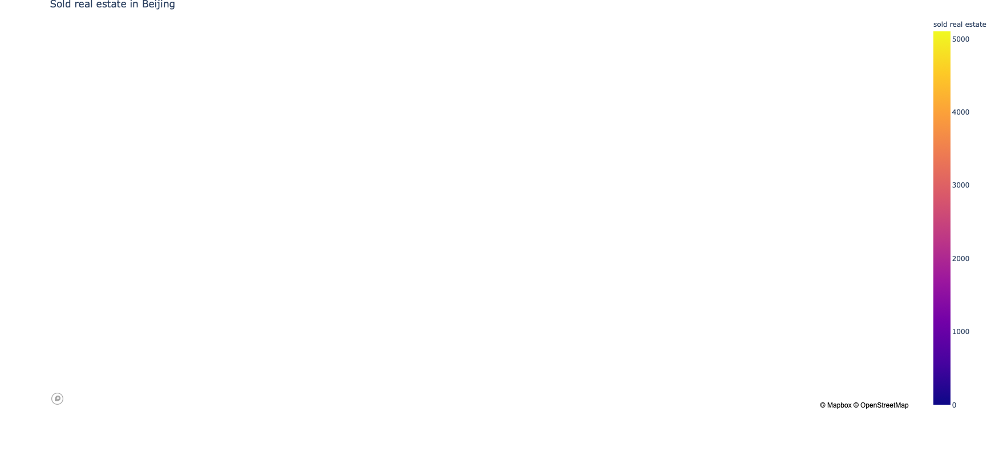

In [14]:
px.set_mapbox_access_token(open(".mapbox_token").read())
fig = ff.create_hexbin_mapbox(data_frame = housing, \
                              lat = "Lat", lon = "Lng", \
                              nx_hexagon = 30, \
                              opacity = 0.2, \
                              labels = {'color' : 'sold real estate'}, \
                              title = 'Sold real estate in Beijing', \
                              height = 800
                             )
fig.update_layout(margin={"t":25})
fig.show()